<a href="https://colab.research.google.com/github/raja9492/project1/blob/main/project_Pneumonia.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import files
import os

uploaded=files.upload()
os.environ['KAGGLE_CONFIG_DIR']="/content"
#!chmod 600 /content/kaggle.json
#!kaggle kernels pull code/gregorkaretka/chest-xray-resnet-0-94-accuracy-on-validation
!kaggle datasets download -d praveengovi/coronahack-chest-xraydataset
!unzip \*.zip  && rm *.zip

Streaming output truncated to the last 5000 lines.
  inflating: Coronahack-Chest-XRay-Dataset/Coronahack-Chest-XRay-Dataset/train/IM-0446-0001.jpeg  
  inflating: Coronahack-Chest-XRay-Dataset/Coronahack-Chest-XRay-Dataset/train/IM-0447-0001.jpeg  
  inflating: Coronahack-Chest-XRay-Dataset/Coronahack-Chest-XRay-Dataset/train/IM-0448-0001.jpeg  
  inflating: Coronahack-Chest-XRay-Dataset/Coronahack-Chest-XRay-Dataset/train/IM-0449-0001.jpeg  
  inflating: Coronahack-Chest-XRay-Dataset/Coronahack-Chest-XRay-Dataset/train/IM-0450-0001.jpeg  
  inflating: Coronahack-Chest-XRay-Dataset/Coronahack-Chest-XRay-Dataset/train/IM-0451-0001.jpeg  
  inflating: Coronahack-Chest-XRay-Dataset/Coronahack-Chest-XRay-Dataset/train/IM-0452-0001.jpeg  
  inflating: Coronahack-Chest-XRay-Dataset/Coronahack-Chest-XRay-Dataset/train/IM-0453-0001-0002.jpeg  
  inflating: Coronahack-Chest-XRay-Dataset/Coronahack-Chest-XRay-Dataset/train/IM-0453-0001.jpeg  
  inflating: Coronahack-Chest-XRay-Dataset/Coronahack

In [ ]:
import cv2 as cv
import os

dataPath='/content/Coronahack-Chest-XRay-Dataset/Coronahack-Chest-XRay-Dataset'
Categories=os.listdir(dataPath)

labels=[i for i in range (len(Categories))]


labeldict={}

for i in range (len(Categories)):
    labeldict[Categories[i]]=labels[i]

print(Categories)
print(labels)
print(labeldict)

['test', 'train']
[0, 1]
{'test': 0, 'train': 1}


**Preparing of Images**

In [ ]:
imageSize=64
Dataset=[]

for Category in Categories:
    folderPath=os.path.join(dataPath,Category)
    #print(folderPath)
    imageNames=os.listdir(folderPath)
    #print(imageNames)

    for imageName in imageNames:
        imagePath=os.path.join(folderPath,imageName)
         #print(imagePath)
        image=cv.imread(imagePath)

        try:
            grayImage = cv.cvtColor(image,cv.COLOR_BGR2GRAY)
            resized=cv.resize(grayImage,(imageSize,imageSize))
            Dataset.append([resized,labeldict[Category]])

        except Exception as e:
            print(e)

**Shuffling the DataSet**

In [ ]:
from random import shuffle

shuffle(Dataset)

In [ ]:
data=[]
target=[]

for feature,label in Dataset:

    data.append(feature)
    target.append(label)

**Data and Target PreProcessing**

In [ ]:
import numpy as np
data=np.array(data)/255
print(data.shape)
data=np.reshape(data,(data.shape[0],imageSize,imageSize,1))
target=np.array(target)
#print(target)
#print(data.shape)
print(data.shape)
print(target.shape)
from keras.utils import np_utils

newTarget=np_utils.to_categorical(target)
#print(newTarget)

(5933, 64, 64)
(5933, 64, 64, 1)
(5933,)


In [ ]:
np.save('dataChestXray',data)
np.save('targetChestXray',newTarget)

In [ ]:
import numpy as np

data=np.load('dataChestXray.npy')
target=np.load('targetChestXray.npy')
print(data.shape[1:])


(64, 64, 1)


CNN ARCHITECTURE


In [ ]:
from keras.models import Sequential
from keras.layers import Dense,Activation,Flatten,Dropout
from keras.layers import Conv2D,MaxPooling2D

model=Sequential()

model.add(Conv2D(32,(3,3),input_shape=data.shape[1:]))
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(Dropout(0.5))

model.add(Conv2D(32,(3,3)))
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(Dropout(0.5))

model.add(Conv2D(64,(3,3)))
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(Dropout(0.5))

model.add(Flatten())

model.add(Dense(128,activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(2,activation='softmax'))

model.compile(loss='categorical_crossentropy',optimizer='adam',metrics=['accuracy'])

In [ ]:
from sklearn.model_selection import train_test_split

train_data,test_data,train_target,test_target=train_test_split(data,target,test_size=0.2)

**Training the dataset**

In [ ]:
history=model.fit(train_data,train_target,epochs=20)

Epoch 1/20
149/149 [==============================] - 13s 7ms/step - loss: 0.3529 - accuracy: 0.8909
Epoch 2/20
149/149 [==============================] - 1s 6ms/step - loss: 0.3485 - accuracy: 0.8963
Epoch 3/20
149/149 [==============================] - 1s 5ms/step - loss: 0.3459 - accuracy: 0.8963
Epoch 4/20
149/149 [==============================] - 1s 6ms/step - loss: 0.3397 - accuracy: 0.8963
Epoch 5/20
149/149 [==============================] - 1s 5ms/step - loss: 0.3427 - accuracy: 0.8963
Epoch 6/20
149/149 [==============================] - 1s 5ms/step - loss: 0.3402 - accuracy: 0.8963
Epoch 7/20
149/149 [==============================] - 1s 5ms/step - loss: 0.3407 - accuracy: 0.8963
Epoch 8/20
149/149 [==============================] - 1s 5ms/step - loss: 0.3377 - accuracy: 0.8963
Epoch 9/20
149/149 [==============================] - 1s 5ms/step - loss: 0.3329 - accuracy: 0.8963
Epoch 10/20
149/149 [==============================] - 1s 5ms/step - loss: 0.3340 - accuracy: 0.896

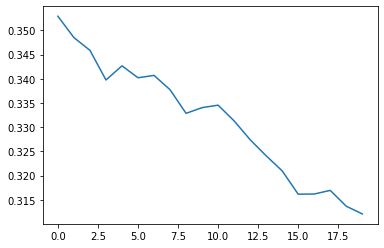

In [ ]:
from matplotlib import pyplot as plt

plt.plot(history.history['loss'])

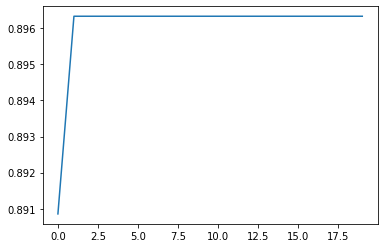

In [ ]:
plt.plot(history.history['accuracy'])

In [ ]:
print(model.evaluate(test_data,test_target))

38/38 [==============================] - 0s 5ms/step - loss: 0.3367 - accuracy: 0.8888
[0.3366958498954773, 0.8887952566146851]


In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 62, 62, 32)        320       
                                                                 
 activation (Activation)     (None, 62, 62, 32)        0         
                                                                 
 max_pooling2d (MaxPooling2D  (None, 31, 31, 32)       0         
 )                                                               
                                                                 
 dropout (Dropout)           (None, 31, 31, 32)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 29, 29, 32)        9248      
                                                                 
 activation_1 (Activation)   (None, 29, 29, 32)        0         
                                                        

In [ ]:
model.save("Pnemonia_predictions_using_chest_xray_99.20.h5")

**Testing the neutral network**

In [ ]:
import numpy as np
from keras.models import Sequential
from keras.layers import Dense,Activation,Flatten,Dropout
from keras.layers import Conv2D,MaxPooling2D

data=np.load('dataChestXray.npy')
target=np.load('targetChestXray.npy')

def loadingCNN():
    model=Sequential()

    model.add(Conv2D(32,(3,3),input_shape=data.shape[1:]))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=(2,2)))
    model.add(Dropout(0.5))

    model.add(Conv2D(32,(3,3)))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=(2,2)))
    model.add(Dropout(0.5))

    model.add(Conv2D(64,(3,3)))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=(2,2)))
    model.add(Dropout(0.5))

    model.add(Flatten())

    model.add(Dense(128,activation='relu'))
    model.add(Dropout(0.5))
    model.add(Dense(2,activation='softmax'))

    model.compile(loss='categorical_crossentropy',optimizer='adam',metrics=['accuracy'])
    model.load_weights('Pnemonia_predictions_using_chest_xray_99.20.h5')
    return model

loadingCNN()

**Preprocessing the images**

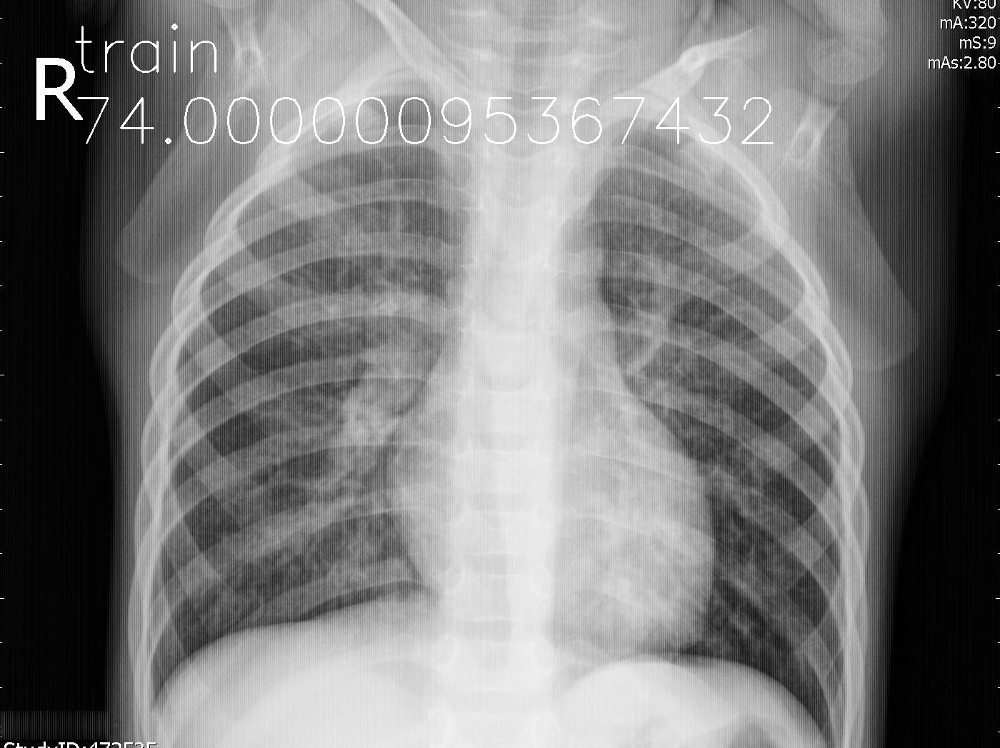

[[0.26086873 0.7391313 ]]


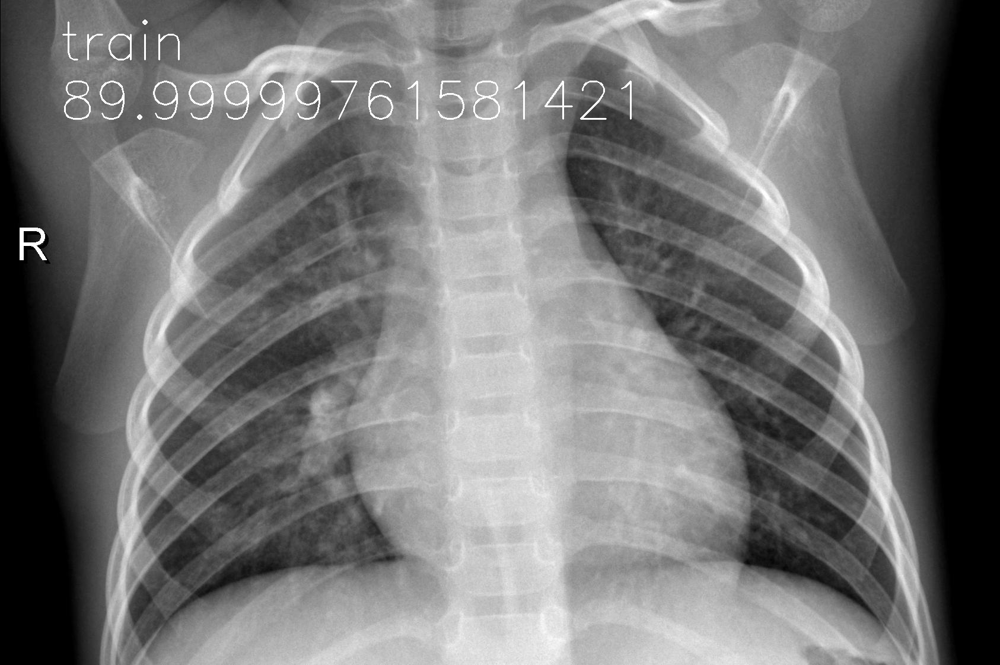

[[0.09701376 0.9029863 ]]


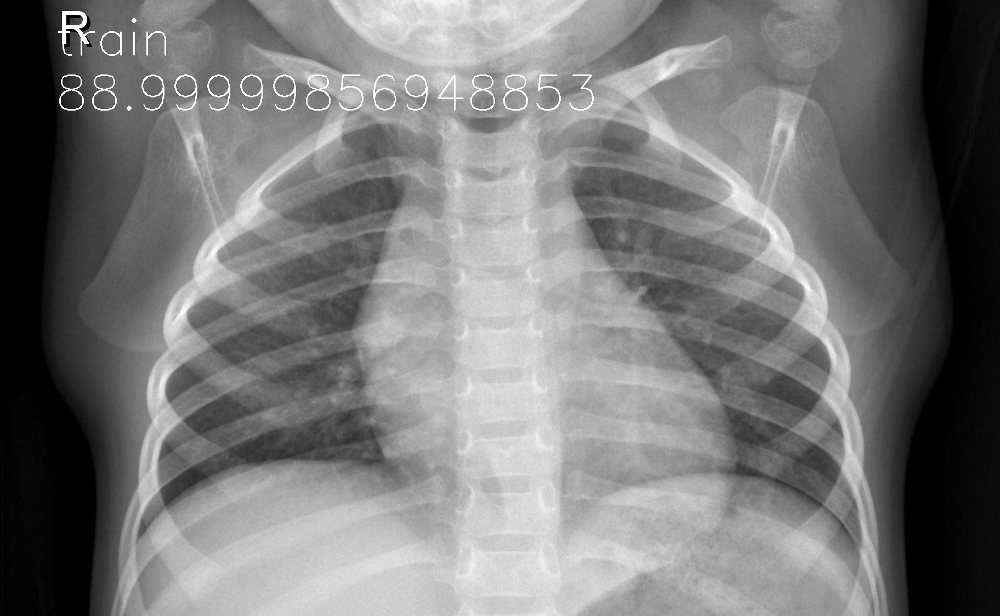

[[0.10992435 0.8900757 ]]


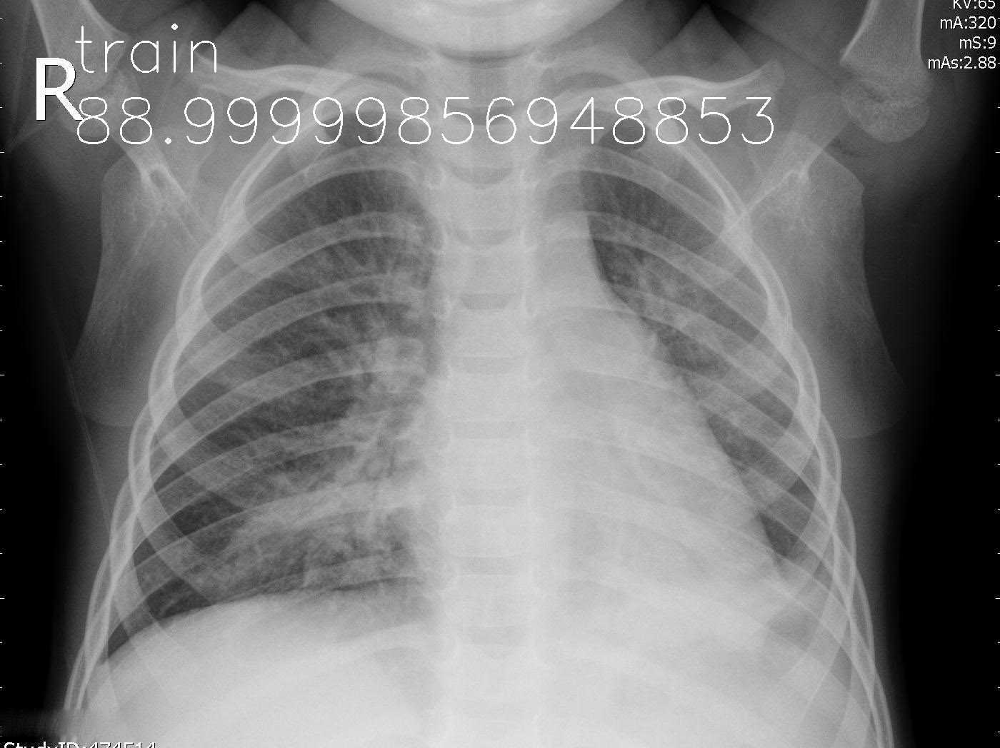

[[0.11231887 0.8876811 ]]


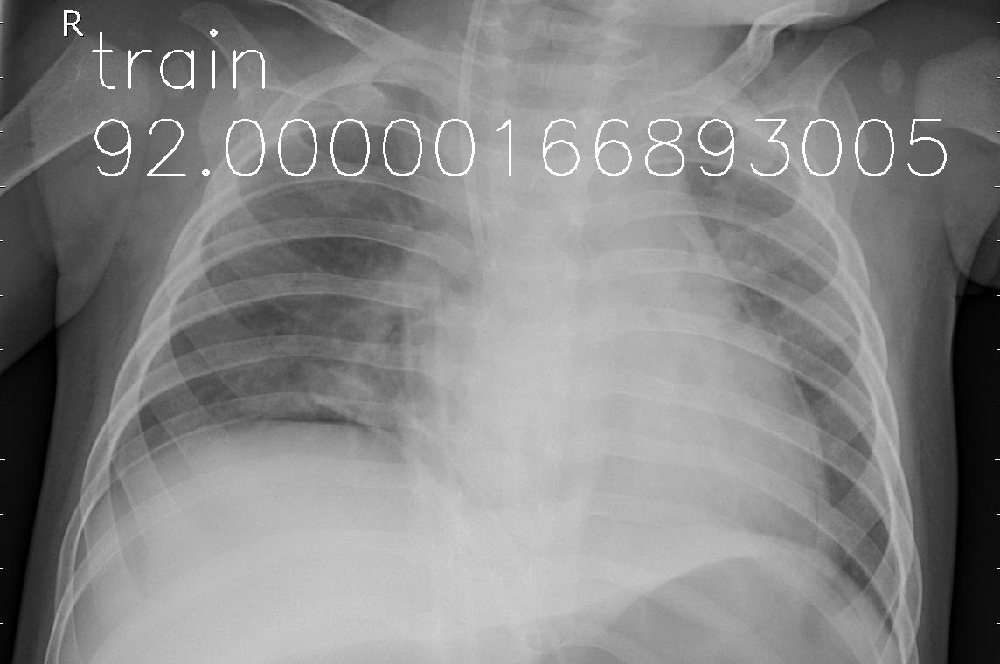

[[0.07779095 0.922209  ]]


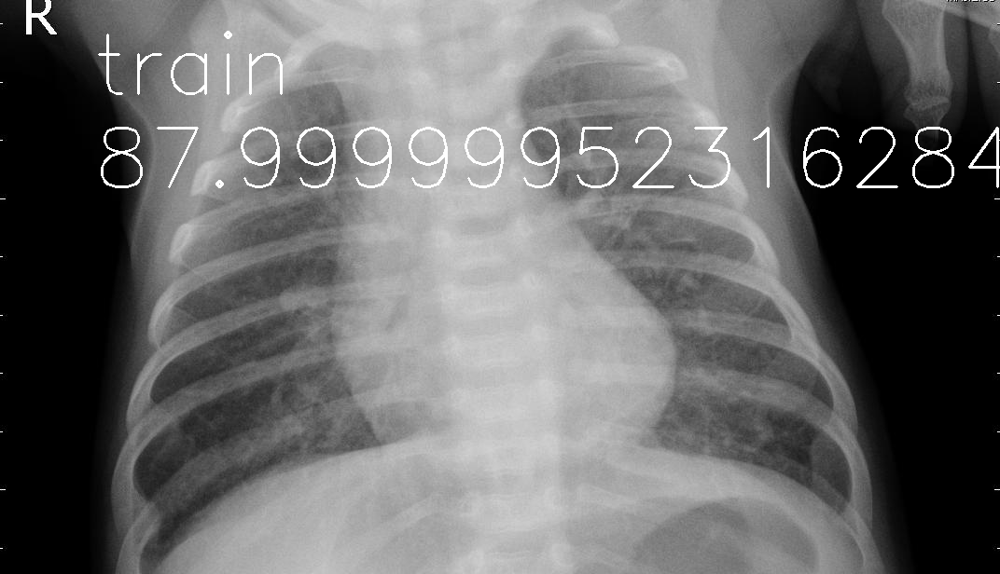

[[0.11907612 0.88092387]]


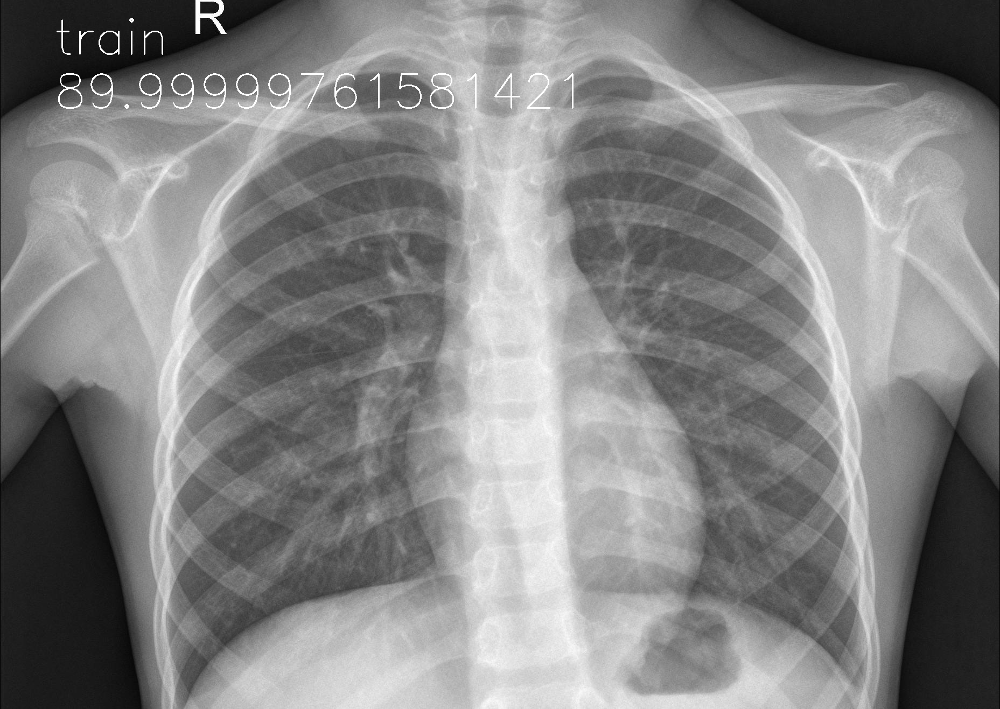

[[0.10265136 0.89734864]]


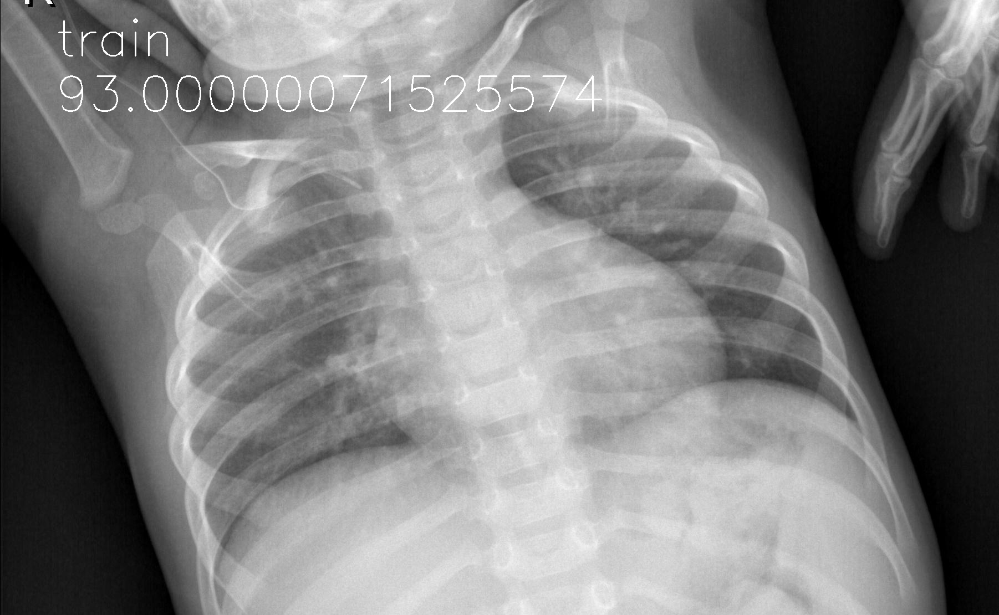

[[0.07304817 0.9269518 ]]


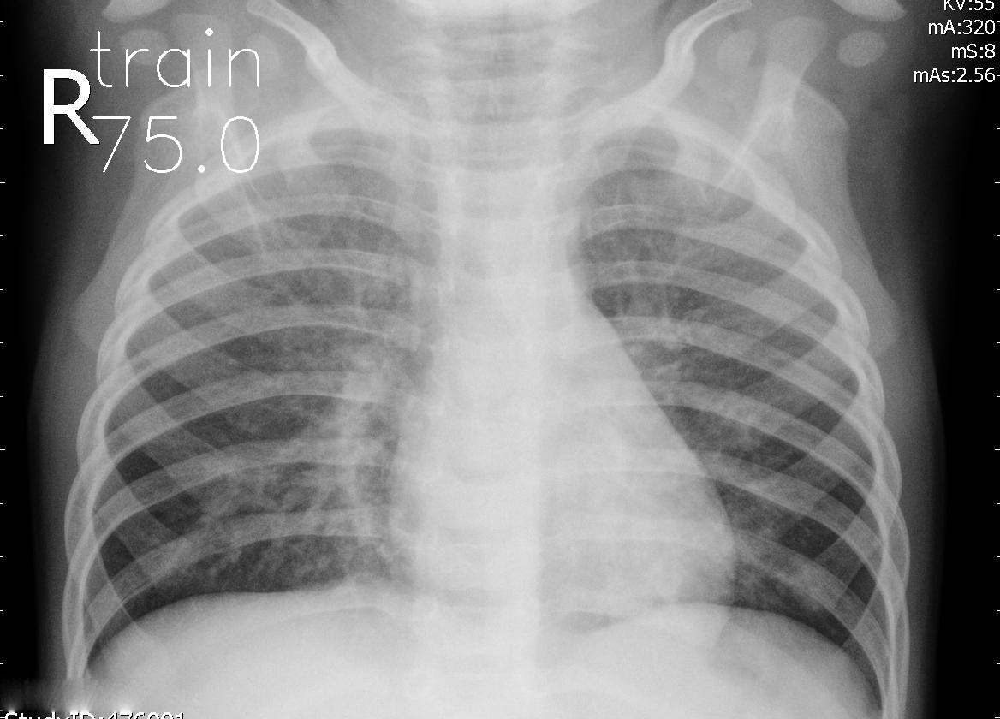

[[0.25138703 0.74861294]]


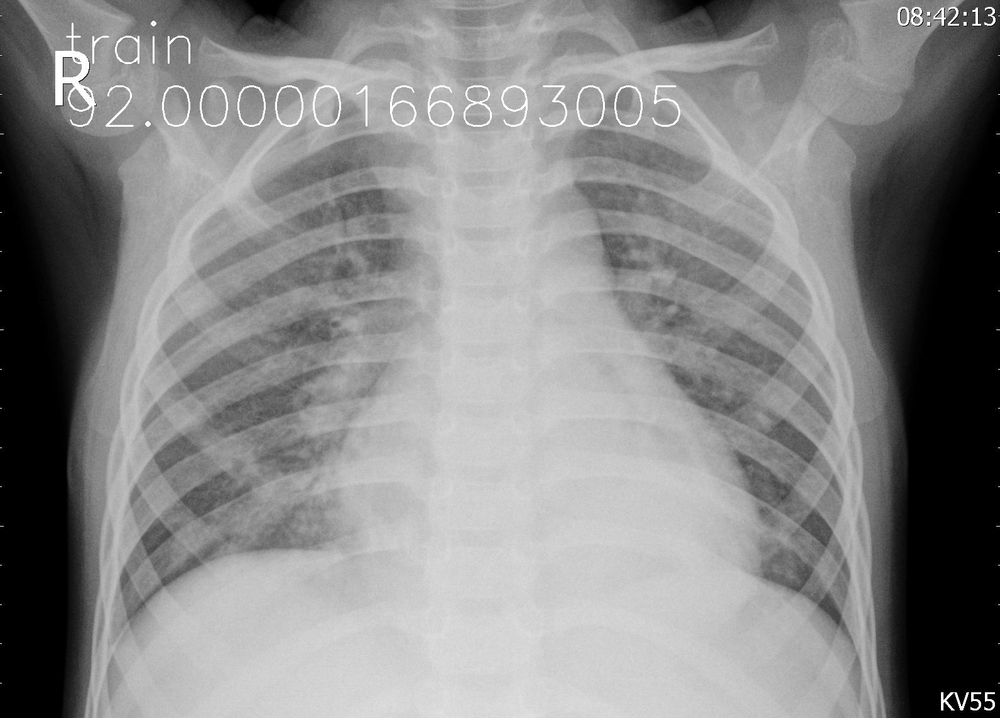

[[0.08061285 0.91938716]]


In [ ]:
from google.colab.patches import cv2_imshow
from random import shuffle
import cv2 as cv
import os

testPath='/content/Coronahack-Chest-XRay-Dataset/Coronahack-Chest-XRay-Dataset/test'
imageNames=os.listdir(testPath)
model=loadingCNN()
category={0:'test',1:'train'}

c=0

for imageName in imageNames:
    c=c+1
    imagePath=os.path.join(testPath,imageName)
    image=cv.imread(imagePath)
    grayImage=cv.cvtColor(image,cv.COLOR_BGR2GRAY)
    resized=cv.resize(grayImage,(64,64))
    normalized=resized/255
    reshaped=np.reshape(normalized,(1,64,64,1))
    result=model.predict(reshaped)
    label=np.argmax(result,axis=1)[0]
    prob=np.max(result,axis=1)[0]
    prob=round(prob,2)*100
#image[:50,:]=[0,255,0]
    cv.putText(image,str(category[label]),(100,100),cv.FONT_HERSHEY_SIMPLEX,3,(255,255,255),2)
    cv.putText(image,str(prob),(100,200),cv.FONT_HERSHEY_SIMPLEX,3,(255,255,255),2)
    cv2_imshow(image)
    cv.waitKey(1000)
    print(result)
    if(c==10):
      break

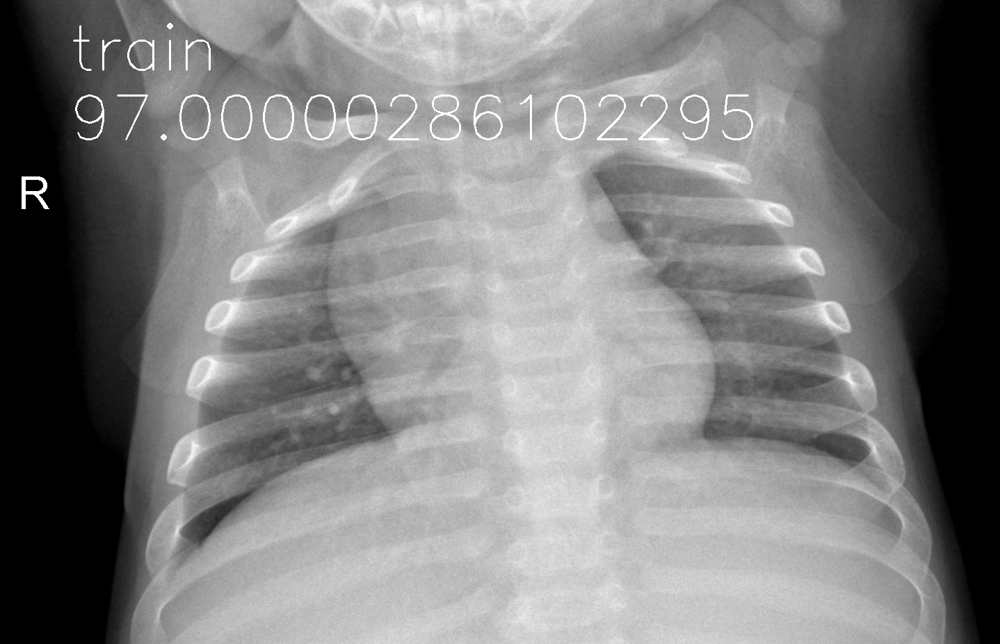

[[0.03214202 0.96785796]]


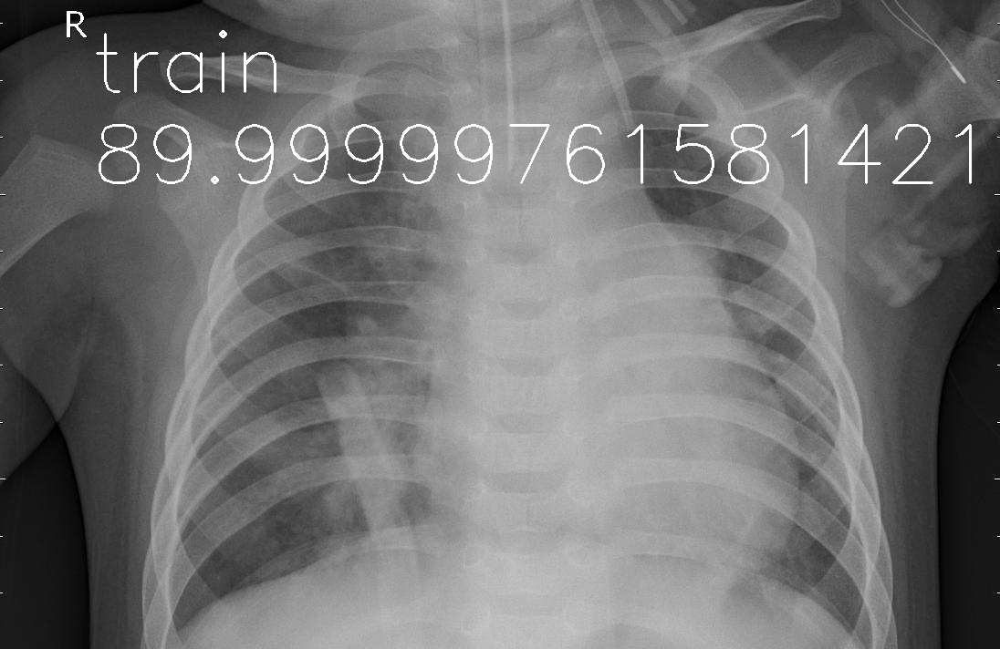

[[0.09733973 0.9026603 ]]


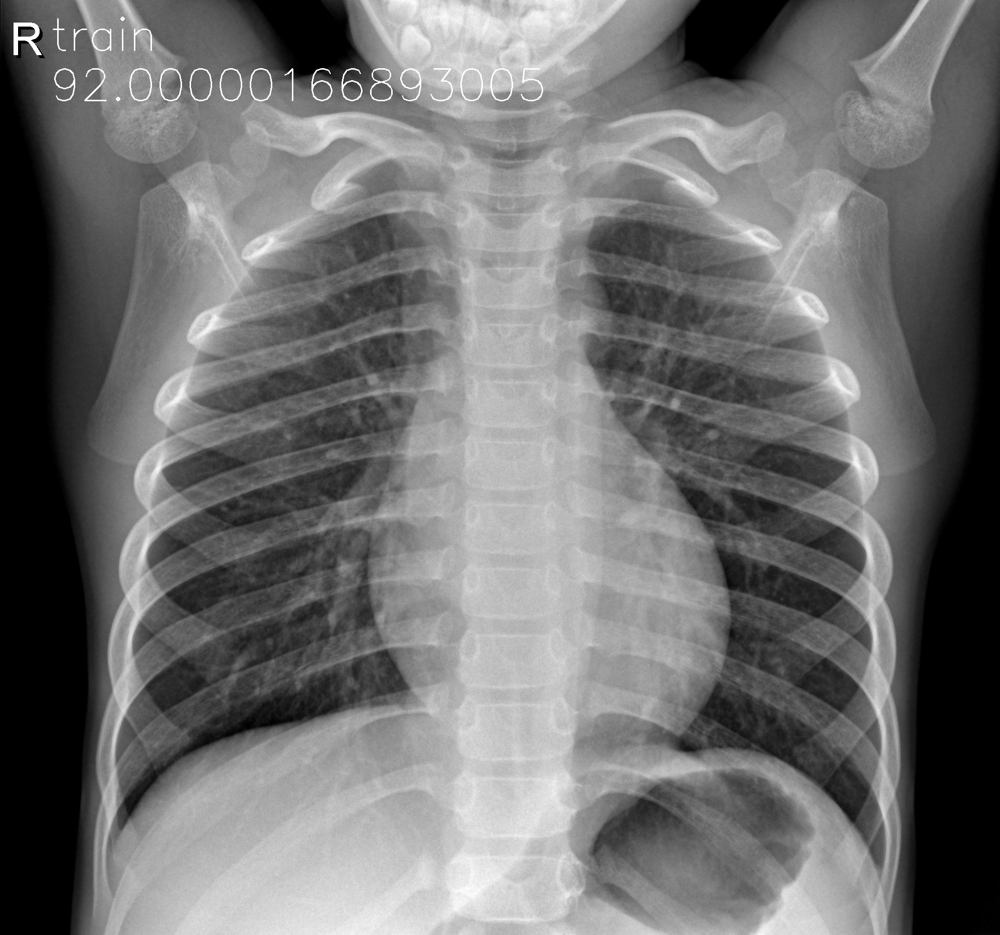

[[0.07977306 0.9202269 ]]


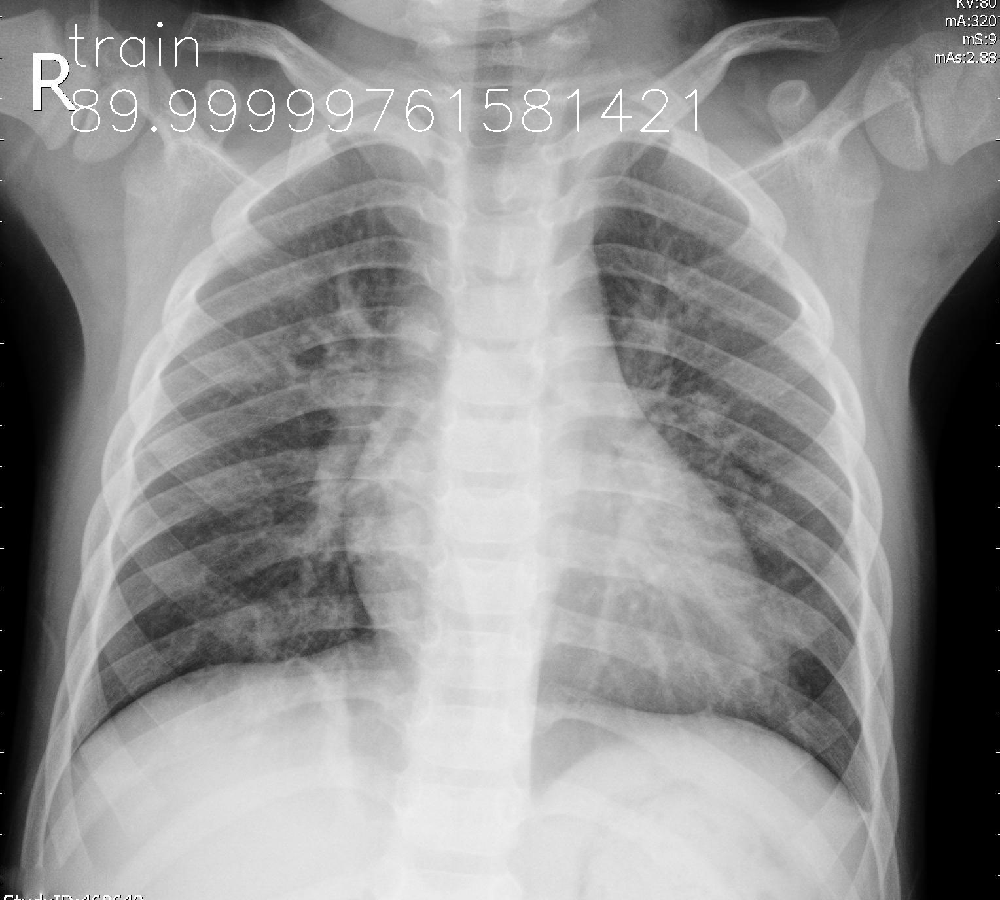

[[0.09814909 0.90185094]]


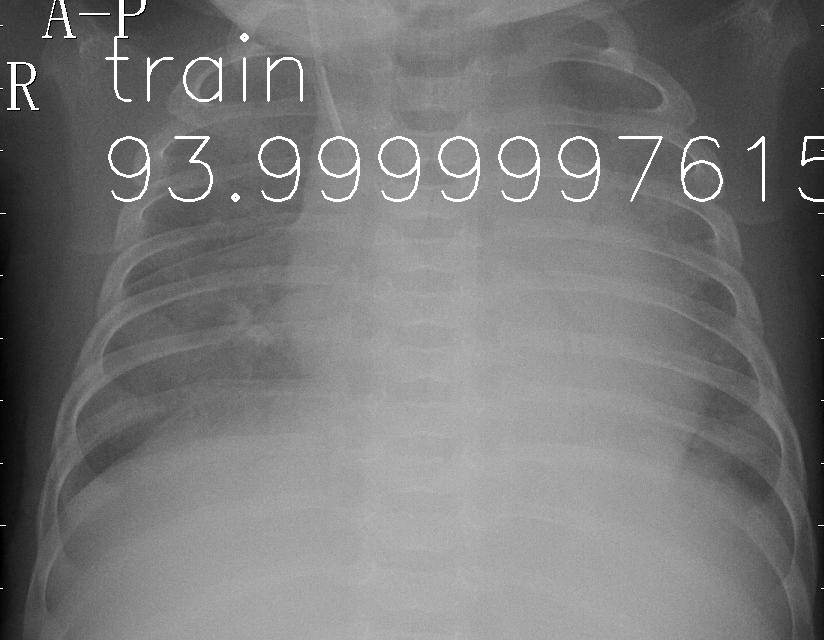

[[0.06460885 0.9353911 ]]


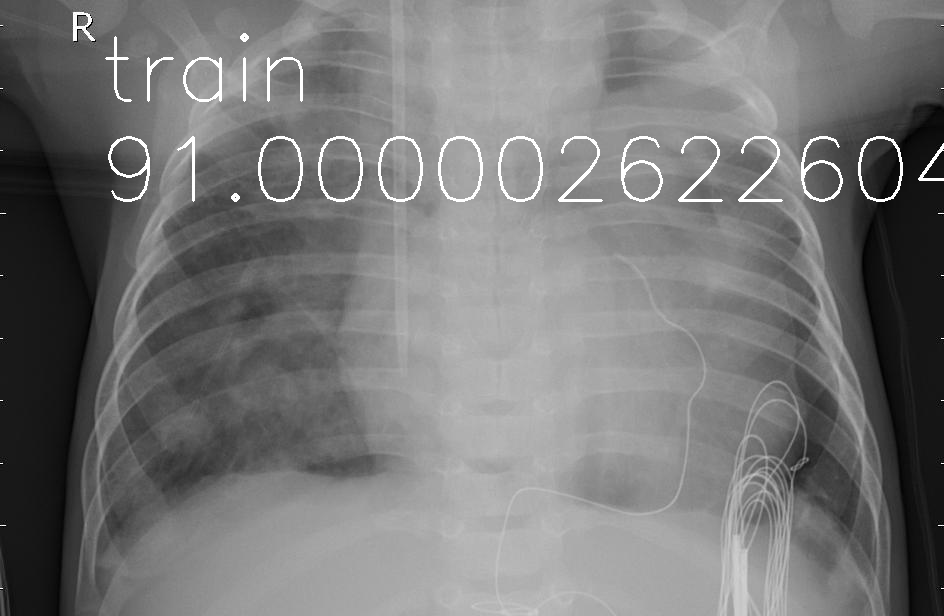

[[0.09474512 0.9052549 ]]


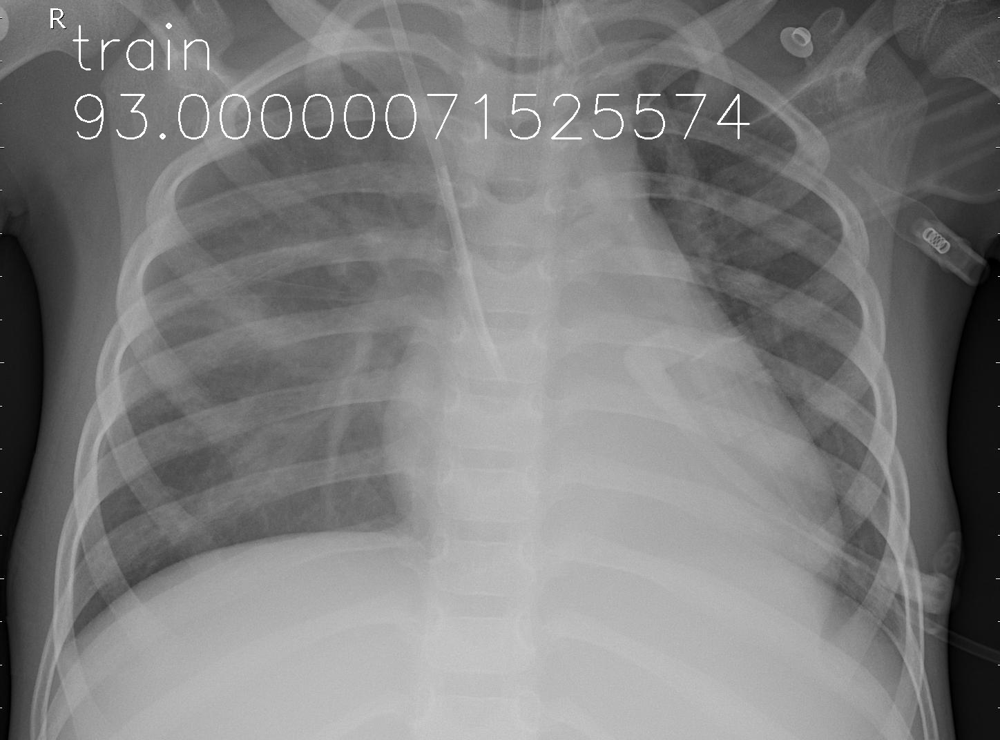

[[0.07495505 0.9250449 ]]


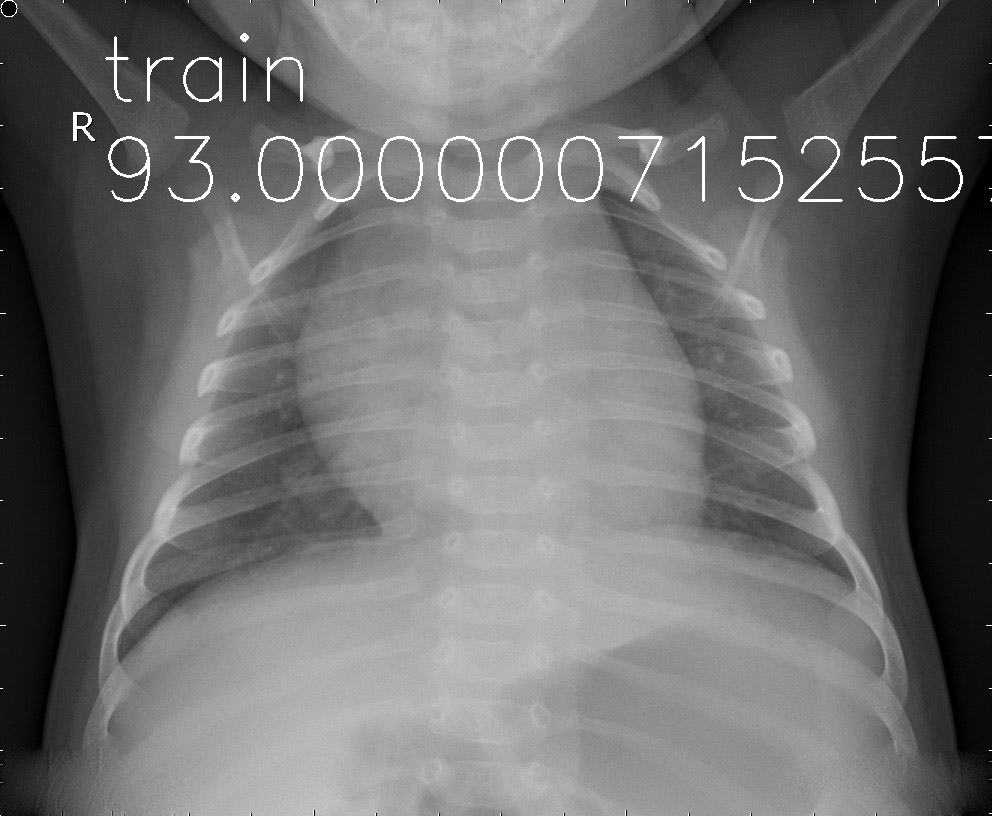

[[0.07333291 0.92666703]]


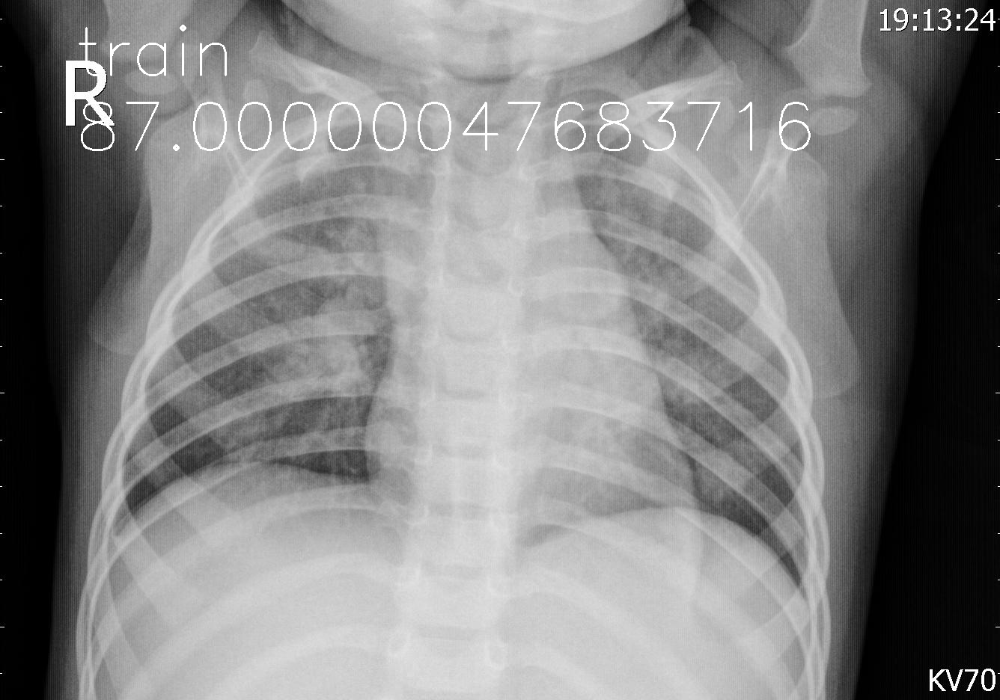

[[0.13401547 0.8659845 ]]


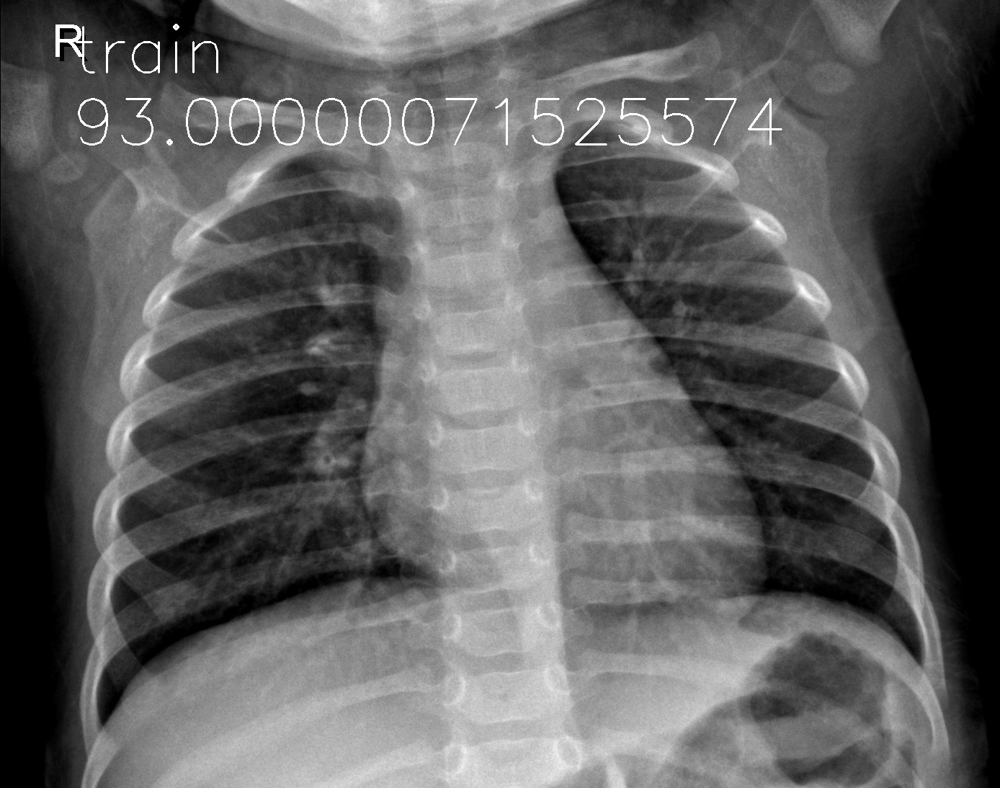

[[0.06590364 0.93409634]]


In [ ]:
from google.colab.patches import cv2_imshow
import cv2 as cv
import os

testPath='/content/Coronahack-Chest-XRay-Dataset/Coronahack-Chest-XRay-Dataset/train'
imageNames=os.listdir(testPath)
model=loadingCNN()
category={0:'test',1:'train'}
c=0

for imageName in imageNames:
    c=c+1
    imagePath=os.path.join(testPath,imageName)
    image=cv.imread(imagePath)
    grayImage=cv.cvtColor(image,cv.COLOR_BGR2GRAY)
    resized=cv.resize(grayImage,(64,64))
    normalized=resized/255
    reshaped=np.reshape(normalized,(1,64,64,1))
    result=model.predict(reshaped)
    label=np.argmax(result,axis=1)[0]
    prob=np.max(result,axis=1)[0]
    prob=round(prob,2)*100
#image[:50,:]=[0,255,0]
    cv.putText(image,str(category[label]),(100,100),cv.FONT_HERSHEY_SIMPLEX,3,(255,255,255),2)
    cv.putText(image,str(prob),(100,200),cv.FONT_HERSHEY_SIMPLEX,3,(255,255,255),2)
    cv2_imshow(image)
    cv.waitKey(1000)
    print(result)
    if(c==10):
      break